In [1]:
import diff_classifier.aws as aws
import skimage.io as sio
import diff_register.register as rg
from skimage import transform as tf
%matplotlib inline

In [2]:
import numpy as np
from dipy.align.imwarp import SymmetricDiffeomorphicRegistration
from dipy.align.metrics import SSDMetric, CCMetric, EMMetric
import dipy.align.imwarp as imwarp
from dipy.viz import regtools

In [3]:
rdir = 'registration'
prefix1 = 'S2_Z1_L'
rfname1 = '{}/{}.tif'.format(rdir, prefix1)
fname1 = '{}.tif'.format(prefix1)
sfname1 = '{}_s.tif'.format(prefix1)

prefix2 = 'S2_Z2_L'
rfname2 = '{}/{}.tif'.format(rdir, prefix2)
fname2 = '{}.tif'.format(prefix2)
sfname2 = '{}_s.tif'.format(prefix2)

In [ ]:
aws.download_s3(rfname1, fname1)
aws.download_s3(rfname2, fname2)

In [ ]:
m1 = sio.imread(fname1)
m2 = sio.imread(fname2)

In [ ]:
m2.shape

In [4]:
test1 = rg.downsample(fname1, colorcol=0)
test2 = rg.downsample(fname2, colorcol=2)

/home/ubuntu/miniconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/home/ubuntu/miniconda3/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: S2_Z1_L_s.tif is a low contrast image
  warn('%s is a low contrast image' % fname)
/home/ubuntu/miniconda3/lib/python3.6/site-packages/skimage/io/_io.py:132: UserWarning: S2_Z2_L_s.tif is a low contrast image
  warn('%s is a low contrast image' % fname)


In [ ]:
im1, im2 = rg.plot_together(test2[:, :, 0], test2[:, :, 2])

In [5]:
def callback_CC(sdr, status):
    #Status indicates at which stage of the optimization we currently are
    #For now, we will only react at the end of each resolution of the scale
    #space
    if status == imwarp.RegistrationStages.SCALE_END:
        #get the current images from the metric
        wmoving = sdr.metric.moving_image
        wstatic = sdr.metric.static_image
        #draw the images on top of each other with different colors
        regtools.overlay_images(wmoving, wstatic, 'Warped moving', 'Overlay', 'Warped static')

In [6]:
static = test2[:, :, 0]
moving = test2[:, :, 2]

In [7]:
sigma_diff = 3.0
radius = 4
metric = CCMetric(2, sigma_diff, radius)

In [8]:
level_iters = [100, 50, 25]
sdr = SymmetricDiffeomorphicRegistration(metric, level_iters)
sdr.callback = callback_CC

Creating scale space from the moving image. Levels: 3. Sigma factor: 0.200000.
Creating scale space from the static image. Levels: 3. Sigma factor: 0.200000.
Optimizing level 2
Optimizing level 1
Optimizing level 0


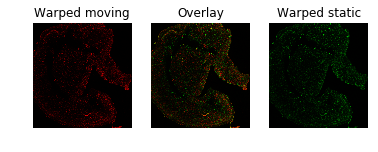

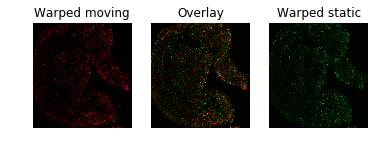

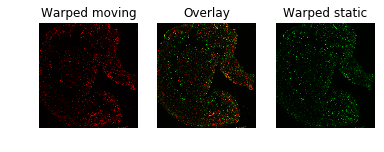

In [9]:
mapping = sdr.optimize(static, moving)

warped = mapping.transform(moving)

In [ ]:
regtools.overlay_images(static[xlo:xhi, ylo:yhi], moving[xlo:xhi, ylo:yhi], 'Static', 'Overlay', 'Moving',
                        'slices_input.png')

In [ ]:
xlo = 200
xhi = 300
ylo = 200
yhi = 300

regtools.overlay_images(static[xlo:xhi, ylo:yhi], warped[xlo:xhi, ylo:yhi], 'Static', 'Overlay', 'Moving',
                        'slices_reg.png')

In [ ]:
regtools.plot_2d_diffeomorphic_map(mapping, 5, 'diffeomorphic_map.png')

In [ ]:
static.shape